In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import os
import glob
import numpy as np
import pandas as pd
import os
import glob
import cv2
import torch
import torch.nn as nn
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc, confusion_matrix, classification_report, f1_score
from sklearn.preprocessing import label_binarize
from itertools import cycle
from PIL import Image
import torch.optim as optim
from tqdm import tqdm

In [2]:
!pip install pytorch-optimizer
!pip install tabulate

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.2/59.2 kB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 192.8/192.8 kB 8.3 MB/s eta 0:00:00


In [3]:
import pandas as pd
import numpy as np

df=pd.read_csv("/kaggle/input/multichannel-glaucoma-benchmark-dataset/metadata - standardized.csv")
df.head()

,names,types,type_expanded,isColor,original_name,patient_id,fundus,fundus_od_seg,fundus_oc_seg,bv_seg,...,cdr_expert4,refractive_dioptre_1,refractive_dioptre_2,refractive_astigmatism,phakic_or_pseudophakic,iop_perkins,iop_pneumatic,pachymetry,axial_length,visual_field_mean_defect
0,OIA-ODIR-TEST-OFFLINE-1,0,NaN,1,1029_right.jpg,NaN,/full-fundus/OIA-ODIR-TEST-OFFLINE-1.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,OIA-ODIR-TEST-OFFLINE-2,0,NaN,1,1049_left.jpg,NaN,/full-fundus/OIA-ODIR-TEST-OFFLINE-2.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,OIA-ODIR-TEST-OFFLINE-4,0,NaN,1,1128_left.jpg,NaN,/full-fundus/OIA-ODIR-TEST-OFFLINE-4.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,OIA-ODIR-TEST-OFFLINE-5,0,NaN,1,1179_right.jpg,NaN,/full-fundus/OIA-ODIR-TEST-OFFLINE-5.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,OIA-ODIR-TEST-OFFLINE-6,0,NaN,1,1180_left.jpg,NaN,/full-fundus/OIA-ODIR-TEST-OFFLINE-6.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
df['types'].value_counts

<bound method IndexOpsMixin.value_counts of 0        0
1        0
2        0
3        0
4        0
        ..
12444    0
12445    0
12446    0
12447    0
12448    0
Name: types, Length: 12449, dtype: int64>

In [5]:
df = df[df['types'] != -1]
df['types'].value_counts()

types
0    7549
1    4767
Name: count, dtype: int64

In [6]:
data=df.sample(frac=1, random_state=42).reset_index(drop=True)
data.head()

,names,types,type_expanded,isColor,original_name,patient_id,fundus,fundus_od_seg,fundus_oc_seg,bv_seg,...,cdr_expert4,refractive_dioptre_1,refractive_dioptre_2,refractive_astigmatism,phakic_or_pseudophakic,iop_perkins,iop_pneumatic,pachymetry,axial_length,visual_field_mean_defect
0,OIA-ODIR-TRAIN-3092,0,NaN,1,4123_right.jpg,NaN,/full-fundus/OIA-ODIR-TRAIN-3092.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,OIA-ODIR-TRAIN-2810,0,NaN,1,3330_right.jpg,NaN,/full-fundus/OIA-ODIR-TRAIN-2810.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,OIA-ODIR-TEST-ONLINE-609,0,NaN,1,3822_right.jpg,NaN,/full-fundus/OIA-ODIR-TEST-ONLINE-609.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,EyePACS-Glaucoma-549,1,Referable Glaucoma,1,TRAIN016366.jpg,NaN,/full-fundus/EyePACS-Glaucoma-549.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,EyePACS-Glaucoma-1774,1,Referable Glaucoma,1,TRAIN053178.jpg,NaN,/full-fundus/EyePACS-Glaucoma-1774.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12316 entries, 0 to 12315
Data columns (total 48 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   names                     12316 non-null  object 
 1   types                     12316 non-null  int64  
 2   type_expanded             6509 non-null   object 
 3   isColor                   12316 non-null  int64  
 4   original_name             12316 non-null  object 
 5   patient_id                420 non-null    object 
 6   fundus                    12316 non-null  object 
 7   fundus_od_seg             3035 non-null   object 
 8   fundus_oc_seg             3035 non-null   object 
 9   bv_seg                    462 non-null    object 
 10  artery_seg                22 non-null     object 
 11  vein_seg                  22 non-null     object 
 12  oct                       79 non-null     object 
 13  oct_oc_seg                45 non-null     object 
 14  oct_od

In [8]:
base_path = '/kaggle/input/multichannel-glaucoma-benchmark-dataset/full-fundus/full-fundus/'
data['image_path'] = base_path + data['names'] + '.png'

data.head()

,names,types,type_expanded,isColor,original_name,patient_id,fundus,fundus_od_seg,fundus_oc_seg,bv_seg,...,refractive_dioptre_1,refractive_dioptre_2,refractive_astigmatism,phakic_or_pseudophakic,iop_perkins,iop_pneumatic,pachymetry,axial_length,visual_field_mean_defect,image_path
0,OIA-ODIR-TRAIN-3092,0,NaN,1,4123_right.jpg,NaN,/full-fundus/OIA-ODIR-TRAIN-3092.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/kaggle/input/multichannel-glaucoma-benchmark-...
1,OIA-ODIR-TRAIN-2810,0,NaN,1,3330_right.jpg,NaN,/full-fundus/OIA-ODIR-TRAIN-2810.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/kaggle/input/multichannel-glaucoma-benchmark-...
2,OIA-ODIR-TEST-ONLINE-609,0,NaN,1,3822_right.jpg,NaN,/full-fundus/OIA-ODIR-TEST-ONLINE-609.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/kaggle/input/multichannel-glaucoma-benchmark-...
3,EyePACS-Glaucoma-549,1,Referable Glaucoma,1,TRAIN016366.jpg,NaN,/full-fundus/EyePACS-Glaucoma-549.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/kaggle/input/multichannel-glaucoma-benchmark-...
4,EyePACS-Glaucoma-1774,1,Referable Glaucoma,1,TRAIN053178.jpg,NaN,/full-fundus/EyePACS-Glaucoma-1774.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/kaggle/input/multichannel-glaucoma-benchmark-...


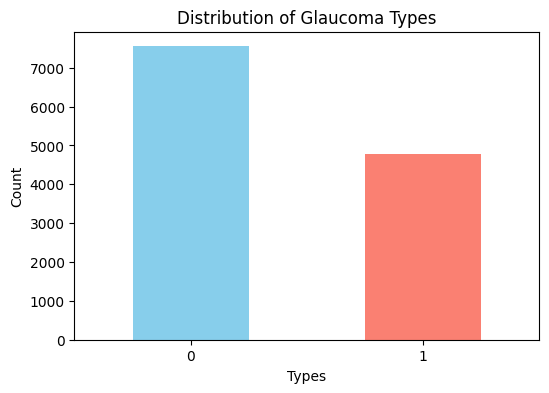

In [9]:
value_counts = data['types'].value_counts()

plt.figure(figsize=(6, 4))
value_counts.plot(kind='bar', color=['skyblue', 'salmon', 'lightgreen'])
plt.title('Distribution of Glaucoma Types')
plt.xlabel('Types')
plt.ylabel('Count')
plt.xticks(ticks=range(len(value_counts)), labels=value_counts.index, rotation=0)
plt.show()

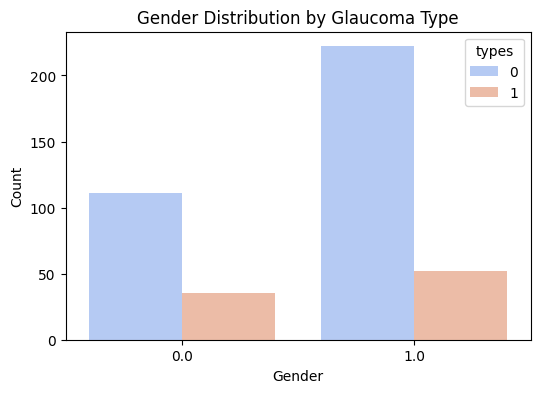

In [10]:
plt.figure(figsize=(6, 4))
sns.countplot(x='gender', hue='types', data=df, palette='coolwarm')
plt.title('Gender Distribution by Glaucoma Type')
plt.xlabel('Gender')
plt.ylabel('Count')
plt.show()

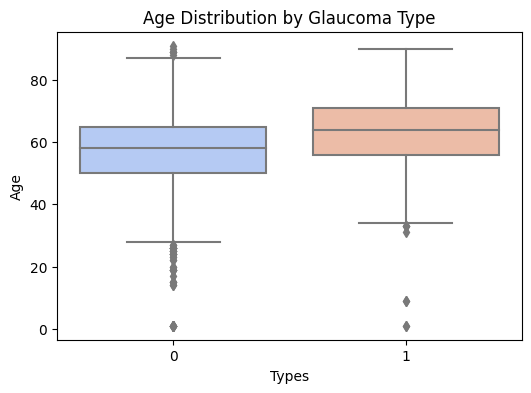

In [11]:
plt.figure(figsize=(6, 4))
sns.boxplot(x='types', y='age', data=df, palette='coolwarm')
plt.title('Age Distribution by Glaucoma Type')
plt.xlabel('Types')
plt.ylabel('Age')
plt.show()


1. The age distribution for the non-glaucoma group (0) shows a much wider range, with ages spanning from younger to older individuals.
2. The age distribution for the glaucoma group (1) is more concentrated in the older age range, exhibiting a narrower overall spread.

**These findings suggest that glaucoma is more commonly diagnosed in older individuals, as reflected by the more concentrated age distribution in the glaucoma group.**

In [12]:
from sklearn.model_selection import train_test_split

train_df, test_df = train_test_split(
    data, 
    test_size=0.3, 
    stratify=data['types'], 
    random_state=42
)

train_df, val_df = train_test_split(
    train_df, 
    test_size=0.3, 
    stratify=train_df['types'], 
    random_state=42
)

In [13]:
train_df['types'].value_counts()

types
0    3698
1    2336
Name: count, dtype: int64

In [14]:
train_df

,names,types,type_expanded,isColor,original_name,patient_id,fundus,fundus_od_seg,fundus_oc_seg,bv_seg,...,refractive_dioptre_1,refractive_dioptre_2,refractive_astigmatism,phakic_or_pseudophakic,iop_perkins,iop_pneumatic,pachymetry,axial_length,visual_field_mean_defect,image_path
8594,G1020-57,0,Healthy,1,image_153.jpg,NaN,/full-fundus/G1020-57.png,/optic-disc/G1020-57.png,/optic-cup/G1020-57.png,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/kaggle/input/multichannel-glaucoma-benchmark-...
2147,sjchoi86-HRF-78,0,Healthy,1,NL_078.png,NaN,/full-fundus/sjchoi86-HRF-78.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/kaggle/input/multichannel-glaucoma-benchmark-...
7940,OIA-ODIR-TRAIN-571,1,NaN,1,1271_right.jpg,NaN,/full-fundus/OIA-ODIR-TRAIN-571.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/kaggle/input/multichannel-glaucoma-benchmark-...
3399,OIA-ODIR-TRAIN-1918,0,NaN,1,2883_right.jpg,NaN,/full-fundus/OIA-ODIR-TRAIN-1918.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/kaggle/input/multichannel-glaucoma-benchmark-...
6108,OIA-ODIR-TEST-ONLINE-877,0,NaN,1,4850_left.jpg,NaN,/full-fundus/OIA-ODIR-TEST-ONLINE-877.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/kaggle/input/multichannel-glaucoma-benchmark-...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10707,OIA-ODIR-TRAIN-1198,0,NaN,1,2523_right.jpg,NaN,/full-fundus/OIA-ODIR-TRAIN-1198.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/kaggle/input/multichannel-glaucoma-benchmark-...
4013,sjchoi86-HRF-357,1,Unknown Glaucoma,1,Glaucoma_057.png,NaN,/full-fundus/sjchoi86-HRF-357.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/kaggle/input/multichannel-glaucoma-benchmark-...
775,sjchoi86-HRF-63,0,Healthy,1,NL_063.png,NaN,/full-fundus/sjchoi86-HRF-63.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/kaggle/input/multichannel-glaucoma-benchmark-...
11881,CRFO-v4-26,1,Unknown Glaucoma,1,Glaucoma-P_22-Left Eye,NaN,/full-fundus/CRFO-v4-26.png,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/kaggle/input/multichannel-glaucoma-benchmark-...


In [15]:
val_df['types'].value_counts()

types
0    1586
1    1001
Name: count, dtype: int64

In [16]:
test_df['types'].value_counts()

types
0    2265
1    1430
Name: count, dtype: int64

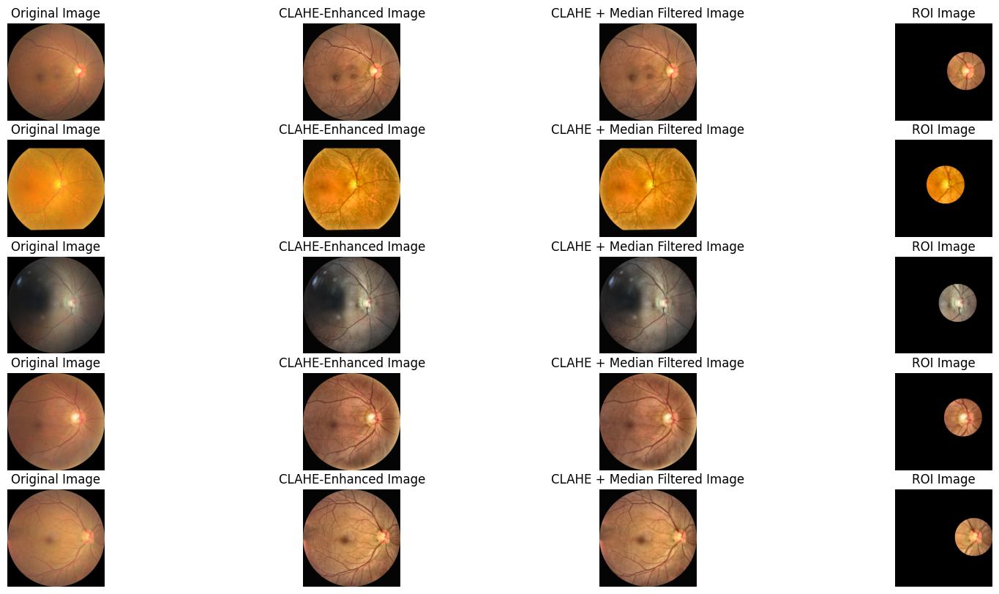

In [17]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

plt.figure(figsize=(20, 10))
sampled_images = train_df["image_path"].sample(5, random_state=42).values

for i, image_path in enumerate(sampled_images):
    image = cv2.imread(image_path)
    
    lab_image = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab_image)
    
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    cl = clahe.apply(l)
    lab_image = cv2.merge((cl, a, b))
    
    clahe_image = cv2.cvtColor(lab_image, cv2.COLOR_LAB2BGR)
    
    median_filtered_image = cv2.medianBlur(clahe_image, 5)

    gray_image = cv2.cvtColor(median_filtered_image, cv2.COLOR_BGR2GRAY)
    blurred_image = cv2.GaussianBlur(gray_image, (65, 65), 0)
    max_intensity_pixel = np.unravel_index(np.argmax(blurred_image), blurred_image.shape)
    
    radius = 200 // 2
    x = max_intensity_pixel[1] - radius
    y = max_intensity_pixel[0] - radius

    mask = np.zeros_like(image)
    cv2.circle(mask, (x + radius, y + radius), radius, (255, 255, 255), -1)
    
    roi_image = cv2.bitwise_and(median_filtered_image, mask)
    
    plt.subplot(5, 4, 4 * i + 1)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title('Original Image')

    plt.subplot(5, 4, 4 * i + 2)
    plt.imshow(cv2.cvtColor(clahe_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title('CLAHE-Enhanced Image')

    plt.subplot(5, 4, 4 * i + 3)
    plt.imshow(cv2.cvtColor(median_filtered_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title('CLAHE + Median Filtered Image')

    plt.subplot(5, 4, 4 * i + 4)
    plt.imshow(cv2.cvtColor(roi_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title('ROI Image')

plt.show()


In [18]:
import torch
from torch.utils.data import Dataset
import cv2
import numpy as np
from torchvision import transforms
from PIL import Image

class GlaucomaImageDataset(Dataset):
    def __init__(self, dataframe, transform=None):
        self.dataframe = dataframe
        self.transform = transform

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        image_path = self.dataframe.iloc[idx]['image_path']
        label = self.dataframe.iloc[idx]['types']
        
        image = cv2.imread(image_path)
        
        lab_image = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        l, a, b = cv2.split(lab_image)
        
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        cl = clahe.apply(l)
        lab_image = cv2.merge((cl, a, b))
        
        clahe_image = cv2.cvtColor(lab_image, cv2.COLOR_LAB2BGR)
        
        median_filtered_image = cv2.medianBlur(clahe_image, 5)
        
        image_rgb = cv2.cvtColor(median_filtered_image, cv2.COLOR_BGR2RGB)
        
        image_pil = Image.fromarray(image_rgb)
        
        if self.transform:
            image_pil = self.transform(image_pil)
        
        return image_pil, label

In [19]:
import torchvision.transforms as transforms

IMAGENET_MEAN = [0.485, 0.456, 0.406]
IMAGENET_STD = [0.229, 0.224, 0.225]

train_transforms = transforms.Compose([
  
    transforms.RandomRotation(degrees=15),                    
    transforms.RandomVerticalFlip(p=0.5),                    
    transforms.RandomHorizontalFlip(p=0.5),              
    transforms.ColorJitter(brightness=0.2),                  
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=IMAGENET_MEAN, std=IMAGENET_STD)
])

test_transforms = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=IMAGENET_MEAN, std=IMAGENET_STD)
])

In [20]:
train_dataset = GlaucomaImageDataset(dataframe=train_df , transform=train_transforms)
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True, num_workers=4)

val_dataset = GlaucomaImageDataset(dataframe=val_df, transform=test_transforms)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False, num_workers=4)

test_dataset = GlaucomaImageDataset(dataframe=test_df, transform=test_transforms)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False, num_workers=4)

train_features, train_labels = next(iter(train_loader))
print(f"Train features shape: {train_features.shape}")
print(f"Train labels shape: {train_labels.shape}")

val_features, val_labels = next(iter(val_loader))
print(f"Validation features shape: {val_features.shape}")
print(f"Validation labels shape: {val_labels.shape}")

test_features, test_labels = next(iter(test_loader))
print(f"Test features shape: {test_features.shape}")
print(f"Test labels shape: {test_labels.shape}")

Train features shape: torch.Size([64, 3, 224, 224])
Train labels shape: torch.Size([64])
Validation features shape: torch.Size([64, 3, 224, 224])
Validation labels shape: torch.Size([64])
Test features shape: torch.Size([64, 3, 224, 224])
Test labels shape: torch.Size([64])


In [21]:
import torch
import torch.nn as nn
from torchvision.models import mobilenet_v3_large, MobileNet_V3_Large_Weights

def build_mobilenetv3_model(num_classes=2):
    model = mobilenet_v3_large(weights=MobileNet_V3_Large_Weights.DEFAULT)
    
    for param in model.parameters():
        param.requires_grad = False
    for param in model.features[-5:].parameters():  
        param.requires_grad = True

    class SpatialSoftAttention(nn.Module):
        def __init__(self, in_channels):
            super(SpatialSoftAttention, self).__init__()
            self.max_pool = nn.MaxPool2d(kernel_size=1, stride=1)
            self.avg_pool = nn.AvgPool2d(kernel_size=1, stride=1)
            self.attn_conv = nn.Conv2d(in_channels * 2, in_channels, kernel_size=1, stride=1)
        
        def forward(self, x):
            maxp_x = self.max_pool(x)
            avgp_x = self.avg_pool(x)
            spat_attn = self.attn_conv(torch.cat([maxp_x, avgp_x], dim=1))
            spat_attn = torch.sigmoid(spat_attn)
            return torch.mul(spat_attn, x)

    
    in_channels = model.features[-1][0].out_channels 
    modules = list(model.features)  
    modules.append(SpatialSoftAttention(in_channels)) 
    modules.append(nn.AdaptiveAvgPool2d((1, 1)))  

    
    classifier_head = nn.Sequential(
        nn.Flatten(),
        nn.Linear(in_channels, 1024), nn.ReLU(),
        nn.Dropout(0.6),
        nn.Linear(1024, 512), nn.ReLU(),
        nn.Dropout(0.4),
        nn.Linear(512, num_classes)
    )
   
    modified_model = nn.Sequential(
        nn.Sequential(*modules),  
        classifier_head           
    )
    
    return modified_model  

In [22]:
import torch
import torch.nn.functional as F
from tqdm import tqdm

def dice_coefficient(pred, target, smooth=1e-6):
    pred = pred.view(-1)
    target = target.view(-1)
    
    intersection = (pred * target).sum()
    dice = (2. * intersection + smooth) / (pred.sum() + target.sum() + smooth)
    return dice

def train_epoch(model, train_loader, criterion, optimizer, device, scaler=None):
    model.train()
    running_loss = 0.0
    total_dice = 0.0
    total = 0

    for inputs, labels in tqdm(train_loader, desc="Training"):
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        # Updated autocast syntax
        with torch.amp.autocast('cuda', enabled=(scaler is not None)):
            outputs = model(inputs)
            loss = criterion(outputs, labels)

        if scaler:
            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()
        else:
            loss.backward()
            optimizer.step()

        running_loss += loss.item()

        pred = outputs.argmax(dim=1)  
        batch_dice = dice_coefficient(pred, labels)
        total_dice += batch_dice.item()

    epoch_loss = running_loss / len(train_loader)
    epoch_dice = total_dice / len(train_loader)
    return epoch_loss, epoch_dice

def validate_epoch(model, val_loader, criterion, device, scaler=None):
    model.eval()
    running_loss = 0.0
    total_dice = 0.0
    total = 0

    with torch.no_grad():
        for inputs, labels in tqdm(val_loader, desc="Validating"):
            inputs, labels = inputs.to(device), labels.to(device)

            with torch.amp.autocast('cuda', enabled=(scaler is not None)):
                outputs = model(inputs)
                loss = criterion(outputs, labels)

            running_loss += loss.item()

            pred = outputs.argmax(dim=1)  
            batch_dice = dice_coefficient(pred, labels)
            total_dice += batch_dice.item()

    epoch_loss = running_loss / len(val_loader)
    epoch_dice = total_dice / len(val_loader)
    return epoch_loss, epoch_dice

def test_model(model, test_loader, device, scaler=None):
    model.eval()
    total_dice = 0.0
    total = 0

    with torch.no_grad():
        for inputs, labels in tqdm(test_loader, desc="Testing"):
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)

            pred = outputs.argmax(dim=1)  
            batch_dice = dice_coefficient(pred, labels)
            total_dice += batch_dice.item()

    test_dice = total_dice / len(test_loader)
    return test_dice

def train_and_validate_model(model, train_loader, val_loader, test_loader, criterion, patience, optimizer, scheduler, device, epochs, model_filename, verbose=True):
    best_val_loss = float('inf')
    epochs_no_improve = 0
    
    total_loss_train = []
    total_loss_val = []
    total_dice_train = []
    total_dice_val = []
    
    for epoch in range(epochs):
        train_loss, train_dice = train_epoch(model, train_loader, criterion, optimizer, device)
        val_loss, val_dice = validate_epoch(model, val_loader, criterion, device)
        scheduler.step(val_loss)
        
        total_loss_train.append(train_loss)
        total_loss_val.append(val_loss)
        total_dice_train.append(train_dice)
        total_dice_val.append(val_dice)
        
        if verbose:
            print(f"Epoch {epoch+1}/{epochs}")
            print(f"Train Loss: {train_loss:.4f}, Train Dice: {train_dice:.4f}")
            print(f"Val Loss: {val_loss:.4f}, Val Dice: {val_dice:.4f}")
        
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            epochs_no_improve = 0
            torch.save(model.state_dict(), model_filename)
            if verbose:
                print(f"New best model saved to {model_filename}")
        else:
            epochs_no_improve += 1
        
        if epochs_no_improve == patience:
            print("Early stopping!")
            break
    
    model.load_state_dict(torch.load(model_filename, weights_only=True))
    test_dice = test_model(model, test_loader, device)
    print(f"Test Dice Coefficient: {test_dice:.4f}")
    
    return model, total_loss_train, total_loss_val, total_dice_train, total_dice_val


In [23]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

num_classes = 2
model=build_mobilenetv3_model(num_classes=2).to(device)

Using device: cuda


Downloading: "https://download.pytorch.org/models/mobilenet_v3_large-5c1a4163.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v3_large-5c1a4163.pth
100%|██████████| 21.1M/21.1M [00:00<00:00, 129MB/s] 


In [24]:
patience = 5
epochs = 60
criterion = nn.CrossEntropyLoss().to(device)
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-3, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=3)

model_filename = 'best_model.pth'

import time
start_time = time.time()
CNN_model_fitted, total_loss_train, total_loss_val, total_dice_train, total_dice_val = train_and_validate_model(
    model, train_loader, val_loader, test_loader, criterion, patience, optimizer, scheduler, device, epochs, model_filename, verbose=True
)

end_time = time.time()

Validating: 100%|██████████| 41/41 [00:24<00:00,  1.68it/s]


Epoch 1/60
Train Loss: 0.4395, Train Dice: 0.6871
Val Loss: 0.5697, Val Dice: 0.6991
New best model saved to best_model.pth


Validating: 100%|██████████| 41/41 [00:21<00:00,  1.93it/s]


Epoch 2/60
Train Loss: 0.3444, Train Dice: 0.7920
Val Loss: 0.3583, Val Dice: 0.8048
New best model saved to best_model.pth


Validating: 100%|██████████| 41/41 [00:20<00:00,  1.96it/s]


Epoch 3/60
Train Loss: 0.2997, Train Dice: 0.8198
Val Loss: 0.3302, Val Dice: 0.7965
New best model saved to best_model.pth


Validating: 100%|██████████| 41/41 [00:21<00:00,  1.92it/s]


Epoch 4/60
Train Loss: 0.2871, Train Dice: 0.8282
Val Loss: 0.3432, Val Dice: 0.8049


Validating: 100%|██████████| 41/41 [00:21<00:00,  1.95it/s]


Epoch 5/60
Train Loss: 0.2714, Train Dice: 0.8464
Val Loss: 0.3461, Val Dice: 0.8037


Validating: 100%|██████████| 41/41 [00:21<00:00,  1.89it/s]


Epoch 6/60
Train Loss: 0.2432, Train Dice: 0.8601
Val Loss: 0.3456, Val Dice: 0.8168


Validating: 100%|██████████| 41/41 [00:20<00:00,  1.96it/s]


Epoch 7/60
Train Loss: 0.2323, Train Dice: 0.8726
Val Loss: 0.5332, Val Dice: 0.8012


Validating: 100%|██████████| 41/41 [00:21<00:00,  1.92it/s]


Epoch 8/60
Train Loss: 0.1810, Train Dice: 0.8934
Val Loss: 0.3419, Val Dice: 0.8332
Early stopping!


Testing: 100%|██████████| 58/58 [00:34<00:00,  1.67it/s]

Test Dice Coefficient: 0.8280


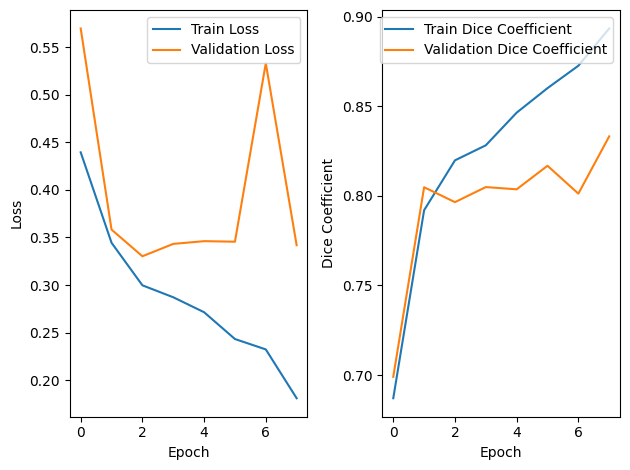

In [25]:
import matplotlib.pyplot as plt
plt.subplot(1, 2, 1)
plt.plot(total_loss_train, label='Train Loss')
plt.plot(total_loss_val, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(total_dice_train, label='Train Dice Coefficient')
plt.plot(total_dice_val, label='Validation Dice Coefficient')
plt.xlabel('Epoch')
plt.ylabel('Dice Coefficient')
plt.legend()

plt.tight_layout()
plt.show()

In [26]:
print("Loading best model and evaluating on test set...")
best_model_state = torch.load('best_model.pth', map_location='cpu', weights_only=True)
model.load_state_dict(best_model_state)
model.to('cpu')
device = torch.device('cpu')

test_dice = test_model(model, test_loader, device)
print(f"Best model's test Dice coefficient: {test_dice:.4f}")

Loading best model and evaluating on test set...


Testing: 100%|██████████| 58/58 [02:08<00:00,  2.21s/it]

Best model's test Dice coefficient: 0.8280


In [27]:
import torch
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc
from sklearn.preprocessing import label_binarize
import random
import itertools
from sklearn.metrics import classification_report, matthews_corrcoef, confusion_matrix, precision_score, recall_score, f1_score, accuracy_score
from prettytable import PrettyTable
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score, accuracy_score



label_mapping = {
   0: 'Non Glaucoma',
   1: 'Glaucoma'
}

def plot_confusion_matrix(cm, classes, title='Confusion matrix', cmap=plt.cm.Blues):
    fig, ax = plt.subplots(figsize=(8, 8))
    
    sns.heatmap(cm, annot=True, fmt='d', cmap=cmap, ax=ax)
    ax.set_title(f'{title} (Non-normalized)', fontsize=16)
    ax.set_ylabel('True label', fontsize=12)
    ax.set_xlabel('Predicted label', fontsize=12)
    ax.set_xticklabels(classes, rotation=45, ha='right', fontsize=10)
    ax.set_yticklabels(classes, rotation=0, fontsize=10)
    
    cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    fig, ax = plt.subplots(figsize=(8, 8))
    sns.heatmap(cm_normalized, annot=True, fmt='.2f', cmap=cmap, ax=ax)
    ax.set_title(f'{title} (Normalized)', fontsize=16)
    ax.set_ylabel('True label', fontsize=12)
    ax.set_xlabel('Predicted label', fontsize=12)
    ax.set_xticklabels(classes, rotation=45, ha='right', fontsize=10)
    ax.set_yticklabels(classes, rotation=0, fontsize=10)
    
    plt.tight_layout()
    plt.savefig('confusion_matrix.png', dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()

def plot_confusion_matrix(cm, classes, title='Confusion matrix', cmap=plt.cm.Blues):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
    
    sns.heatmap(cm, annot=True, fmt='d', cmap=cmap, ax=ax1)
    ax1.set_title(f'{title} (Non-normalized)', fontsize=14)
    ax1.set_ylabel('True label', fontsize=12)
    ax1.set_xlabel('Predicted label', fontsize=12)
    ax1.set_xticklabels(classes, rotation=45, ha='right', fontsize=10)
    ax1.set_yticklabels(classes, rotation=0, fontsize=10)

    cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    sns.heatmap(cm_normalized, annot=True, fmt='.2f', cmap=cmap, ax=ax2)
    ax2.set_title(f'{title} (Normalized)', fontsize=14)
    ax2.set_ylabel('True label', fontsize=12)
    ax2.set_xlabel('Predicted label', fontsize=12)
    ax2.set_xticklabels(classes, rotation=45, ha='right', fontsize=10)
    ax2.set_yticklabels(classes, rotation=0, fontsize=10)
    
    plt.tight_layout()
    plt.savefig('confusion_matrix.png', dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()


def plot_roc_curve(all_labels, all_probs, label_mapping):
    positive_class_name = label_mapping[1]
    positive_probs = all_probs[:, 1]  # Extract probabilities for the positive class

    # Compute the ROC curve and AUC for the positive class
    fpr, tpr, _ = roc_curve(all_labels, positive_probs)
    roc_auc = auc(fpr, tpr)

    # Plot the ROC curve
    plt.figure(figsize=(10, 7))
    plt.plot(fpr, tpr, color='blue', lw=2, label=f'{positive_class_name} (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='gray', linestyle='--', lw=1)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate', fontsize=12)
    plt.ylabel('True Positive Rate', fontsize=12)
    plt.title('Receiver Operating Characteristic (ROC) Curve', fontsize=16)
    plt.legend(loc="lower right", fontsize=10)
    plt.savefig('roc_curve_binary.png', dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()

def plot_sample_images(model, test_loader, device, label_mapping, num_images=10):
    model.eval()
    all_images = []
    all_labels = []
    
    # Collect all images and labels from the test loader
    for images, labels in test_loader:
        all_images.extend(images)
        all_labels.extend(labels)
    
    total_images = len(all_images)
    
    # Randomly select a subset of images to display
    indices = random.sample(range(total_images), num_images)
    selected_images = torch.stack([all_images[i] for i in indices])
    selected_labels = torch.tensor([all_labels[i] for i in indices])
    
    # Move the images to the specified device
    selected_images = selected_images.to(device)
    
    # Get predictions and probabilities
    with torch.no_grad():
        outputs = model(selected_images)
        probs = torch.softmax(outputs, dim=1)
        preds = torch.argmax(outputs, dim=1)
    
    # Plot settings
    rows = int(np.ceil(num_images / 5))
    cols = min(num_images, 5)
    fig, axes = plt.subplots(rows, cols, figsize=(20, 4 * rows))
    
    for i, ax in enumerate(axes.flat):
        if i < num_images:
            # Normalize the image for display
            img = selected_images[i].cpu().permute(1, 2, 0).numpy()
            img = (img - img.min()) / (img.max() - img.min())
            
            # Fetch true and predicted labels along with confidence
            true_label = label_mapping[selected_labels[i].item()]
            pred_label = label_mapping[preds[i].item()]
            confidence = probs[i][preds[i]].item()
            
            # Display the image with the title
            ax.imshow(img)
            ax.set_title(
                f"True: {true_label}\nPred: {pred_label}\nConf: {confidence:.2f}",
                fontsize=10
            )
        ax.axis('off')
    
    plt.tight_layout()
    plt.savefig('sample_predictions_binary.png', dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()


from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score, accuracy_score
import numpy as np
import pandas as pd

def calculate_metrics(y_true, y_pred, label_mapping):
    # Confusion Matrix
    cm = confusion_matrix(y_true, y_pred)
    tp = cm[1, 1]  # True Positives
    tn = cm[0, 0]  # True Negatives
    fp = cm[0, 1]  # False Positives
    fn = cm[1, 0]  # False Negatives

    # Sensitivity, Specificity, and MCC
    sensitivity = tp / (tp + fn) if tp + fn > 0 else 0
    specificity = tn / (tn + fp) if tn + fp > 0 else 0
    mcc = ((tp * tn) - (fp * fn)) / np.sqrt((tp + fp) * (tp + fn) * (tn + fp) * (tn + fn)) if (tp + fp) * (tp + fn) * (tn + fp) * (tn + fn) > 0 else 0

    # Precision, Recall, F1-Score, Accuracy
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    accuracy = accuracy_score(y_true, y_pred)

    # Dice Coefficient
    dice = (2 * tp) / (2 * tp + fp + fn) if (2 * tp + fp + fn) > 0 else 0

    # Metrics in DataFrame
    metrics_df = pd.DataFrame({
        'Metric': ['Accuracy', 'Precision', 'Recall (Sensitivity)', 'F1-Score', 'Specificity', 'MCC', 'Dice Coefficient'],
        'Value': [
            accuracy * 100,
            precision * 100,
            recall * 100,
            f1 * 100,
            specificity * 100,
            mcc,
            dice * 100
        ]
    }).round(2)

    return metrics_df



Evaluating: 100%|██████████| 58/58 [02:07<00:00,  2.19s/it]


Metrics DataFrame:
+----------------------+---------+
| Metric               |   Value |
+======================+=========+
| Accuracy             |   87.93 |
+----------------------+---------+
| Precision            |   90.80 |
+----------------------+---------+
| Recall (Sensitivity) |   76.57 |
+----------------------+---------+
| F1-Score             |   83.08 |
+----------------------+---------+
| Specificity          |   95.10 |
+----------------------+---------+
| MCC                  |    0.74 |
+----------------------+---------+
| Dice Coefficient     |   83.08 |
+----------------------+---------+

Classification Report:
              precision    recall  f1-score   support

Non Glaucoma       0.91      0.77      0.83      1430
    Glaucoma       0.87      0.95      0.91      2265

    accuracy                           0.88      3695
   macro avg       0.89      0.86      0.87      3695
weighted avg       0.88      0.88      0.88      3695


Overall Metrics:
+----------------

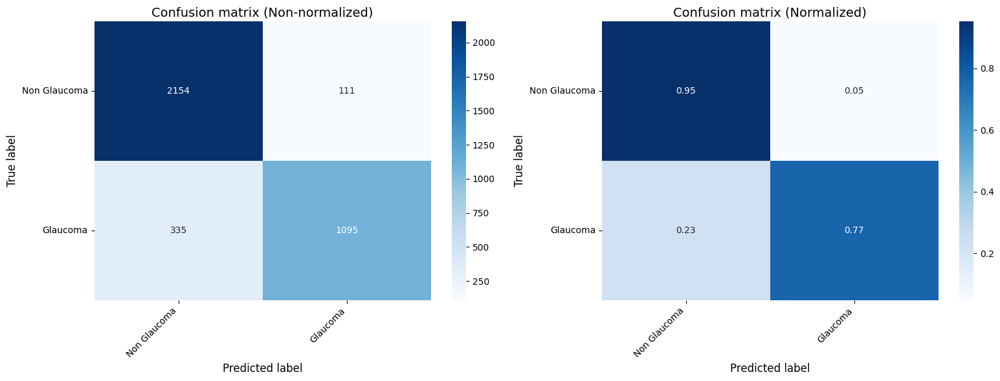

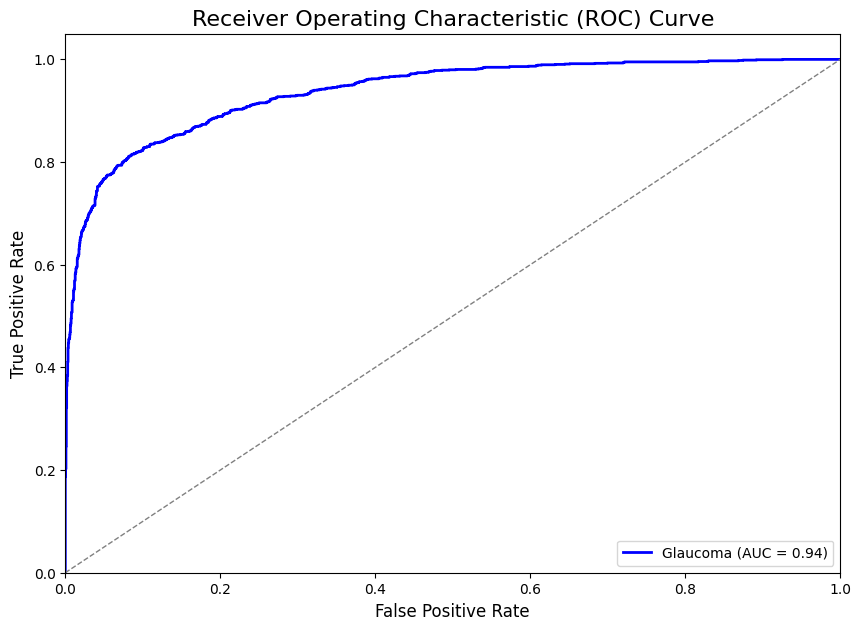

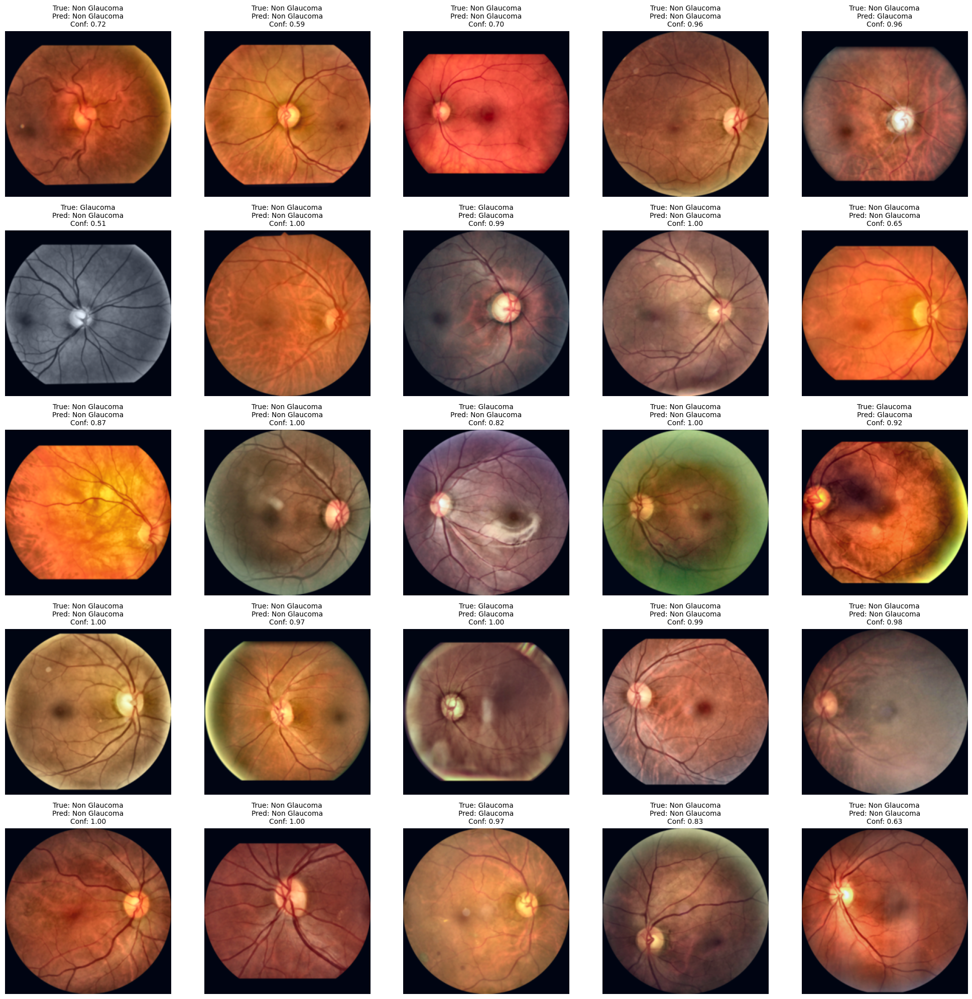

In [28]:
from tabulate import tabulate
def print_metrics_df(metrics_df):
    df_as_list = metrics_df.values.tolist()
    headers = metrics_df.columns.tolist()
    print(tabulate(df_as_list, headers=headers, tablefmt='grid', floatfmt=".2f"))

def evaluate_model(model, test_loader, device):
    model.eval()
    all_preds = []
    all_labels = []
    all_probs = []
    
    with torch.no_grad():
        for inputs, labels in tqdm(test_loader, desc="Evaluating"):
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            probs = torch.softmax(outputs, dim=1)
            _, preds = torch.max(outputs, 1)
            
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
            all_probs.extend(probs.cpu().numpy())
    
    all_preds = np.array(all_preds)
    all_labels = np.array(all_labels)
    all_probs = np.array(all_probs)  
    
    metrics_df = calculate_metrics(all_labels, all_preds,label_mapping)
    
    print("Metrics DataFrame:")
    print_metrics_df(metrics_df)
    mapped_preds = [label_mapping[pred] for pred in all_preds]
    mapped_labels = [label_mapping[label] for label in all_labels]
    class_names = [label_mapping[i] for i in range(2)]
    
    print("\nClassification Report:")
    print(classification_report(mapped_labels, mapped_preds, target_names=class_names))
    
    # Overall Metrics
    accuracy = accuracy_score(all_labels, all_preds)
    precision = precision_score(all_labels, all_preds, zero_division=0)
    recall = recall_score(all_labels, all_preds, zero_division=0)
    f1 = f1_score(all_labels, all_preds, zero_division=0)
    mcc = matthews_corrcoef(all_labels, all_preds)
    
    print("\nOverall Metrics:")
    overall_metrics = [
        ["Accuracy", f"{accuracy:.4f}"],
        ["Precision", f"{precision:.4f}"],
        ["Recall (Sensitivity)", f"{recall:.4f}"],
        ["F1 Score", f"{f1:.4f}"],
        ["Matthews Correlation Coefficient (MCC)", f"{mcc:.4f}"]
    ]
    print(tabulate(overall_metrics, headers=["Metric", "Value"], tablefmt='grid'))
    
    # Confusion Matrix
    cm = confusion_matrix(all_labels, all_preds)
    plot_confusion_matrix(cm, class_names)
    
    # ROC Curve
    plot_roc_curve(all_labels, all_probs, class_names)
  
    # Sample Predictions
    plot_sample_images(model, test_loader, device, label_mapping, num_images=25)

evaluate_model(model, test_loader, device)

In [29]:
import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
import cv2

class GradCAM:
    def __init__(self, model):
        self.model = model
        self.feature_extractor = model[0]  # Get the feature extraction part
        # Target the last conv layer before attention
        self.target_layer = self.feature_extractor[-3]
        self.gradients = None
        self.activations = None
        
        # Register hooks
        self.target_layer.register_forward_hook(self.save_activation)
        self.target_layer.register_full_backward_hook(self.save_gradient)
    
    def save_activation(self, module, input, output):
        self.activations = output
    
    def save_gradient(self, module, grad_input, grad_output):
        self.gradients = grad_output[0]
    
    def __call__(self, x, class_idx=None):
        self.model.eval()
        
        # Forward pass
        output = self.model(x)
        if class_idx is None:
            class_idx = output.argmax(dim=1)
        
        # Zero gradients
        self.model.zero_grad()
        
        # Target for backprop
        one_hot = torch.zeros_like(output)
        one_hot[0][class_idx] = 1
        
        # Backward pass
        output.backward(gradient=one_hot, retain_graph=True)
        
        # Global average pooling
        weights = torch.mean(self.gradients, dim=(2, 3))
        
        # Generate cam
        cam = torch.sum(weights[:, :, None, None] * self.activations, dim=1)
        cam = F.relu(cam)
        
        # Normalize
        cam = cam - torch.min(cam)
        cam = cam / (torch.max(cam) + 1e-7)
        
        return cam.detach().cpu().numpy()

class GradCAMPlusPlus:
    def __init__(self, model):
        self.model = model
        self.feature_extractor = model[0]
        self.target_layer = self.feature_extractor[-3]  # Adjusted for your architecture
        self.gradients = None
        self.activations = None
        
        # Register hooks
        self.target_layer.register_forward_hook(self.save_activation)
        self.target_layer.register_full_backward_hook(self.save_gradient)
    
    def save_gradient(self, module, grad_input, grad_output):
        self.gradients = grad_output[0]
    
    def save_activation(self, module, input, output):
        self.activations = output
    
    def __call__(self, x, class_idx=None):
        self.model.eval()
        
        # Forward pass
        output = self.model(x)
        if class_idx is None:
            class_idx = output.argmax(dim=1)
        
        # Zero gradients
        self.model.zero_grad()
        
        # Target for backprop
        one_hot = torch.zeros_like(output)
        one_hot[0][class_idx] = 1
        
        # Backward pass
        output.backward(gradient=one_hot, retain_graph=True)
        
        # Calculate alpha weights
        grad = self.gradients[0]
        activation = self.activations[0]
        alpha_num = grad.pow(2)
        alpha_denom = 2.0 * grad.pow(2)
        alpha_denom += torch.sum(activation * grad.pow(3), dim=(1, 2), keepdim=True)
        alpha = alpha_num / (alpha_denom + 1e-7)
        
        # Weight calculation
        weights = torch.sum(alpha * F.relu(grad), dim=(1, 2))
        
        # Generate cam
        cam = torch.sum(weights[:, None, None] * activation, dim=0)
        cam = F.relu(cam)
        
        # Normalize
        cam = cam - torch.min(cam)
        cam = cam / (torch.max(cam) + 1e-7)
        
        return cam.detach().cpu().numpy()


Analyzing image 1/25


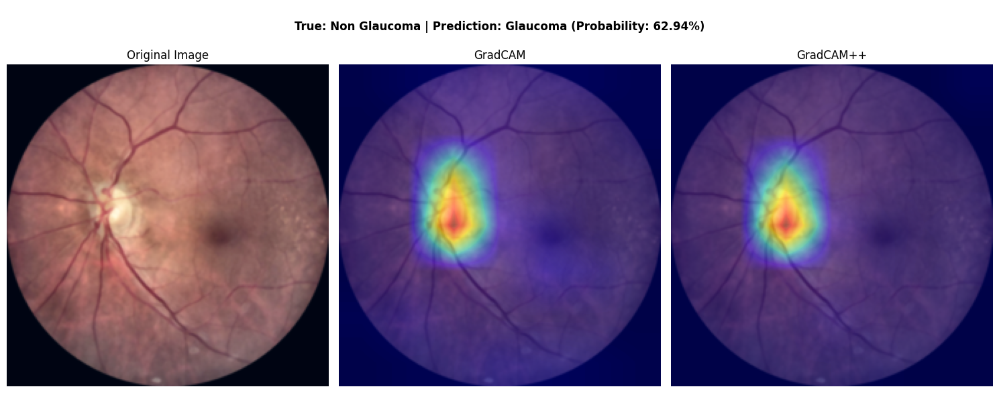


Analyzing image 2/25


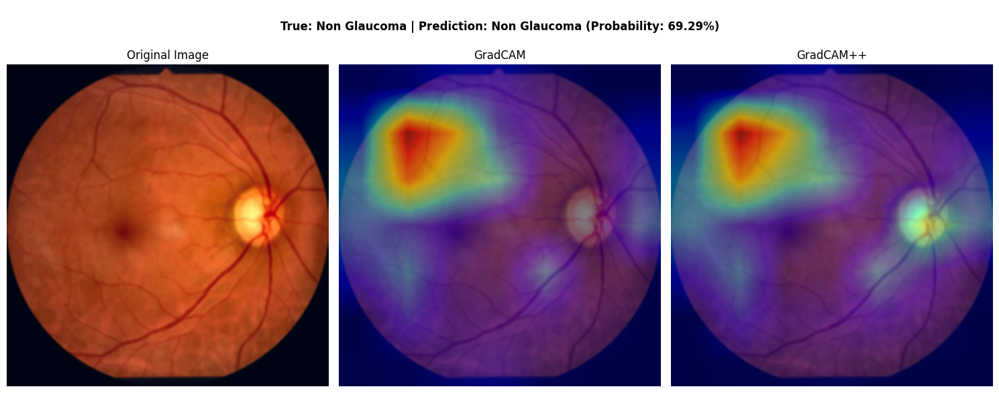


Analyzing image 3/25


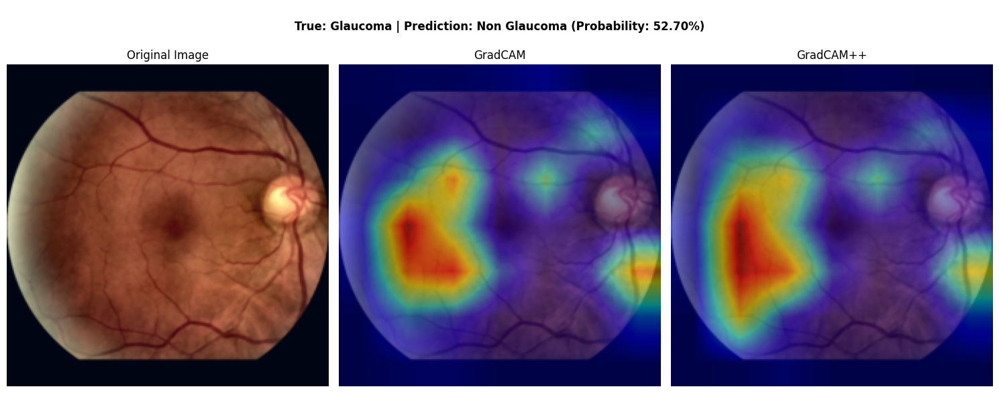


Analyzing image 4/25


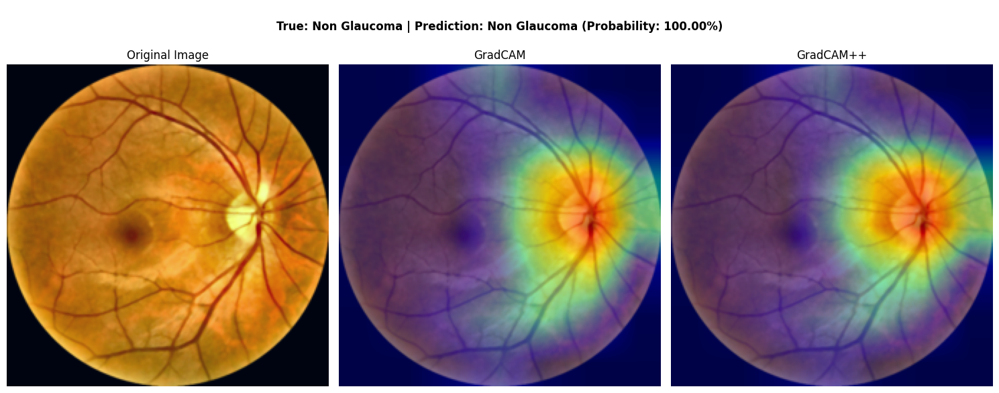


Analyzing image 5/25


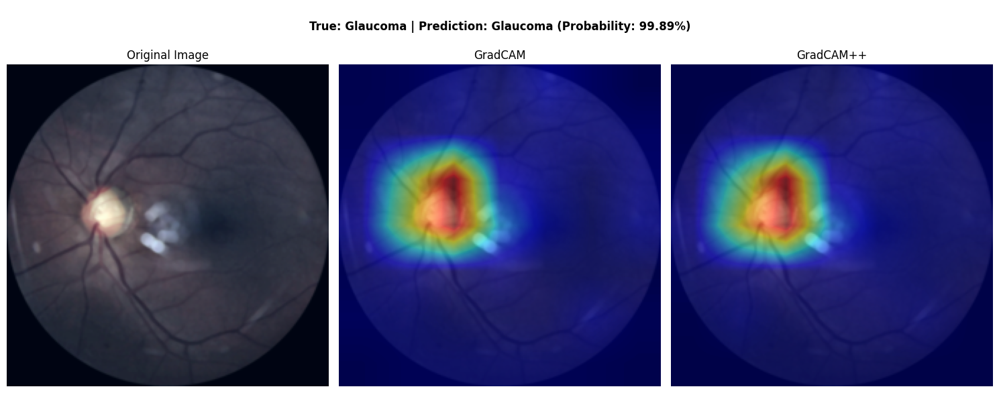


Analyzing image 6/25


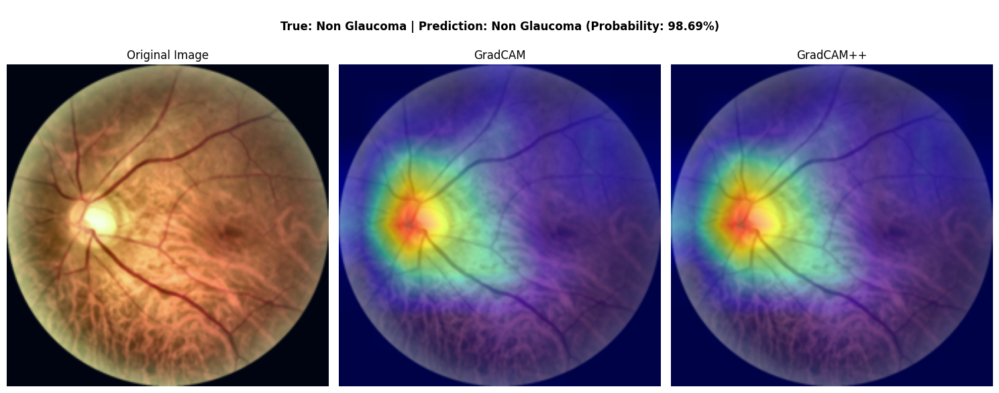


Analyzing image 7/25


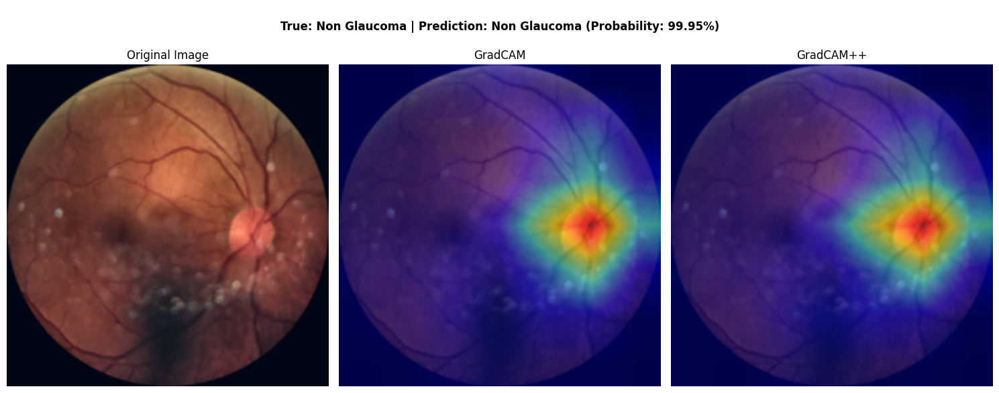


Analyzing image 8/25


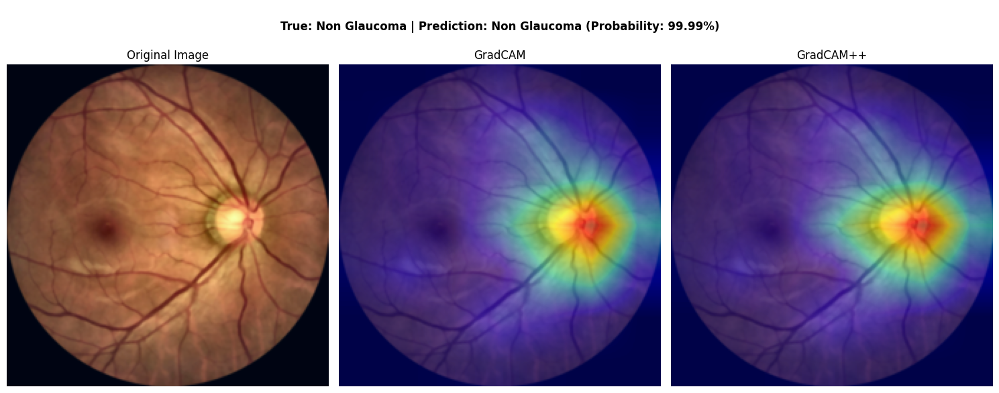


Analyzing image 9/25


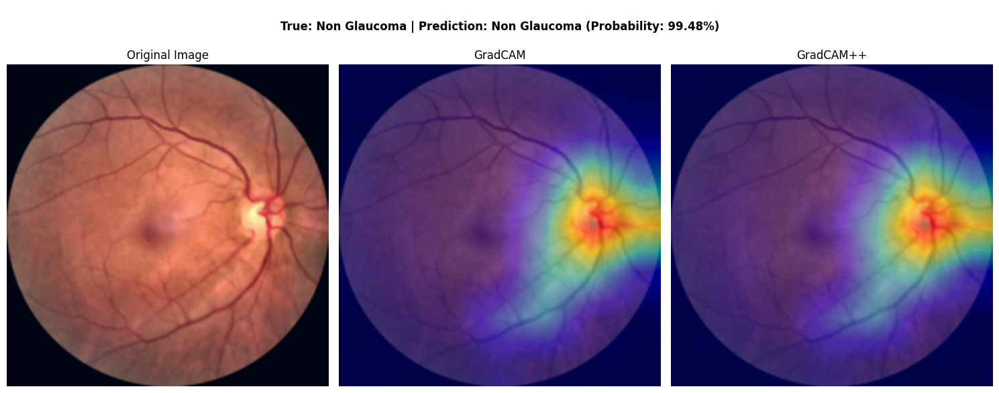


Analyzing image 10/25


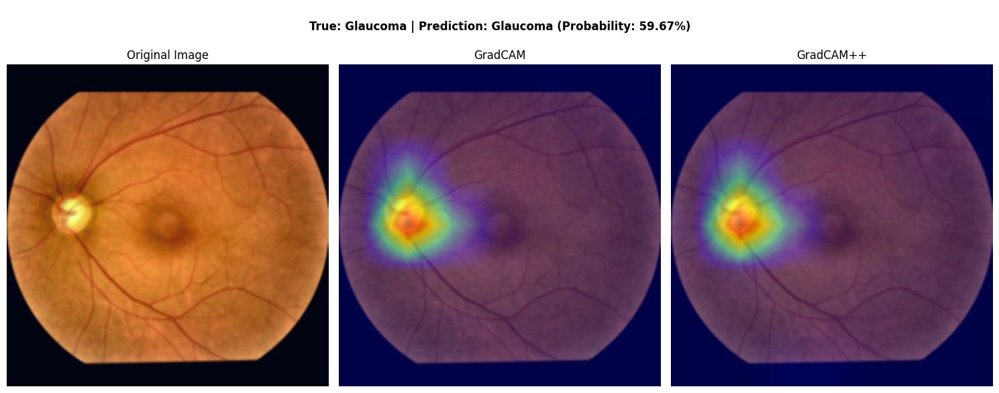


Analyzing image 11/25


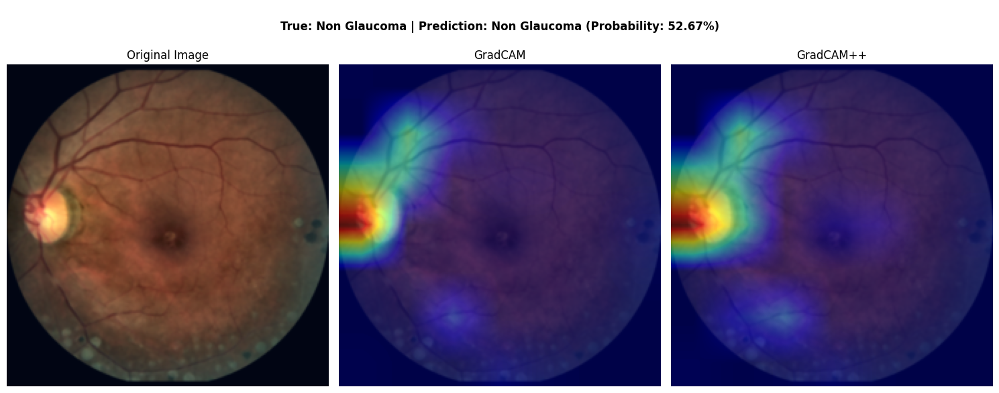


Analyzing image 12/25


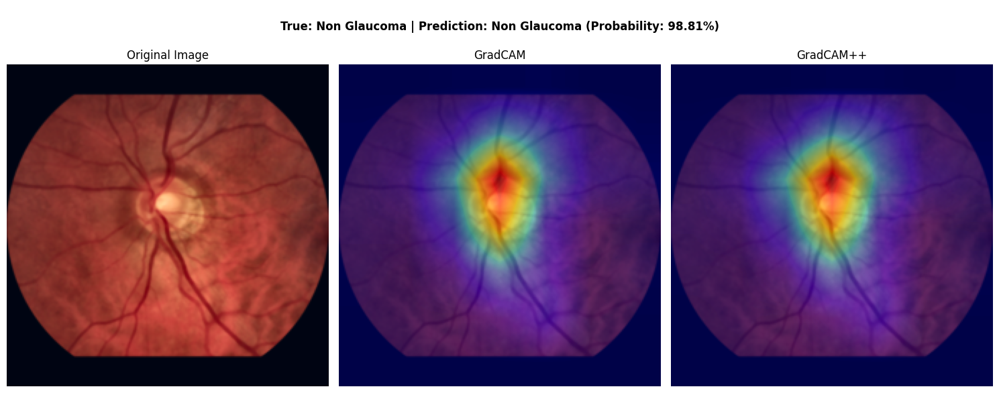


Analyzing image 13/25


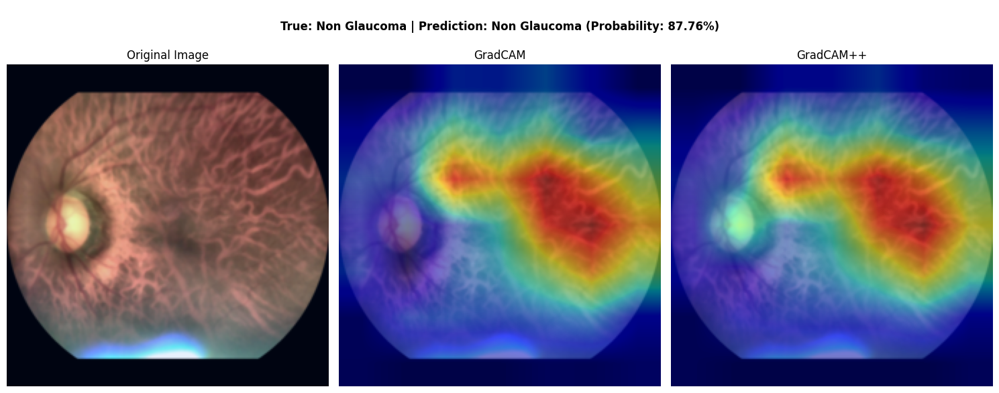


Analyzing image 14/25


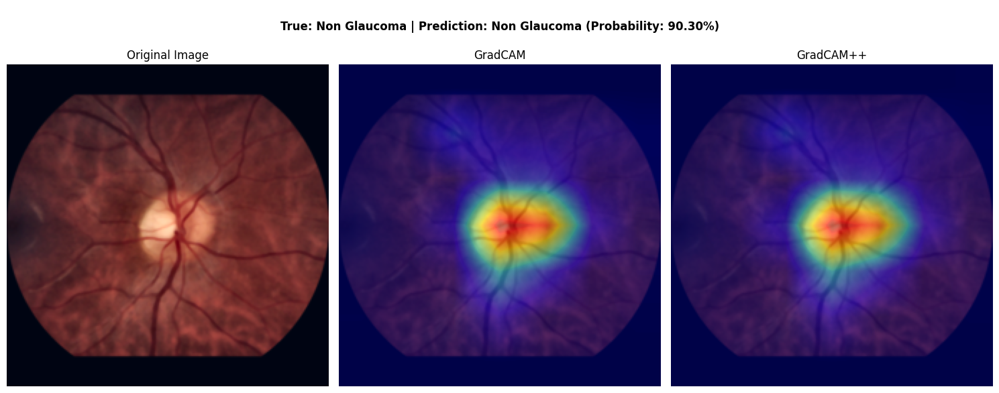


Analyzing image 15/25


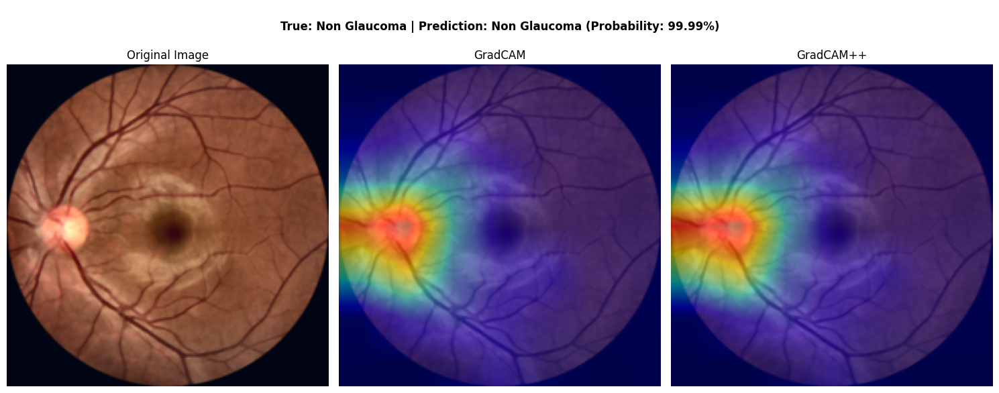


Analyzing image 16/25


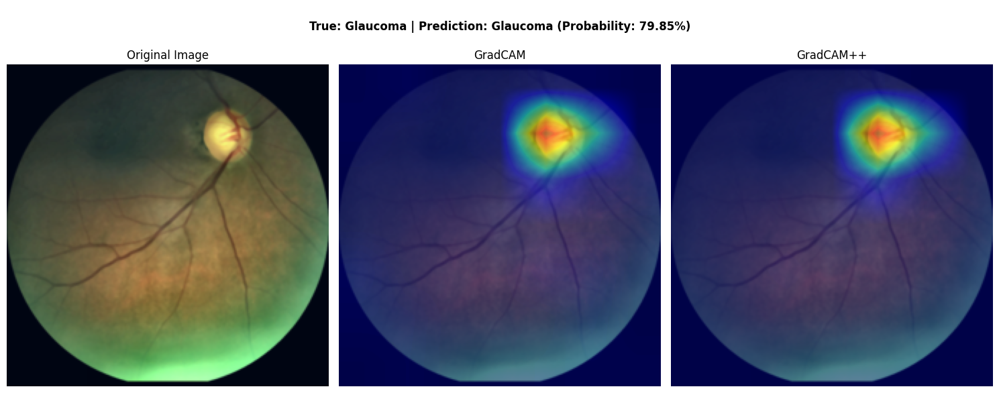


Analyzing image 17/25


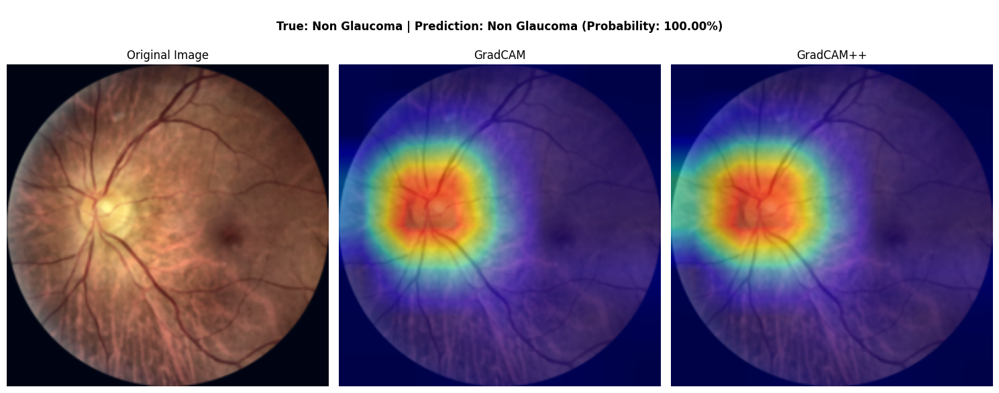


Analyzing image 18/25


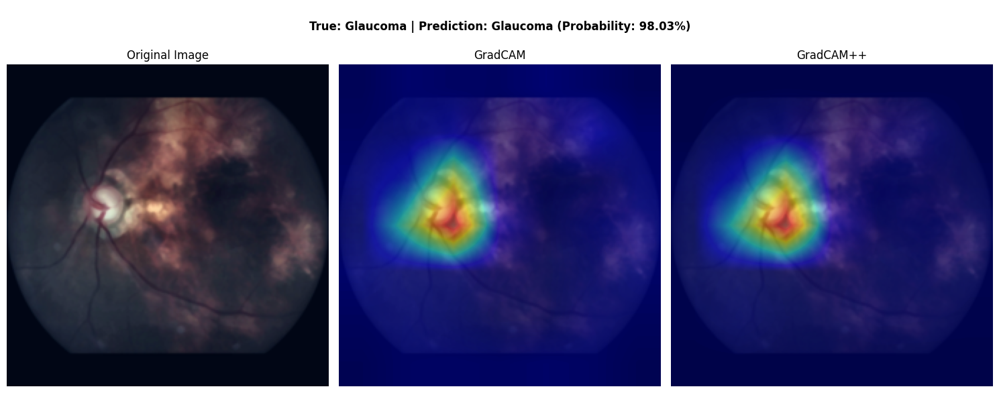


Analyzing image 19/25


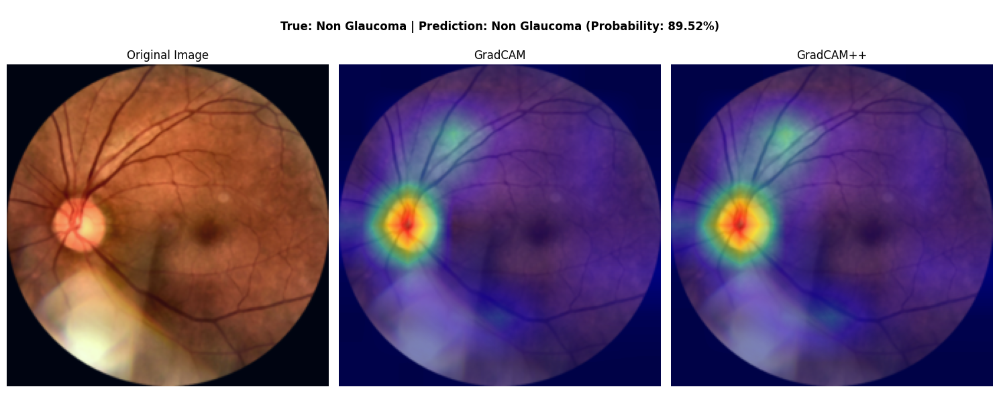


Analyzing image 20/25


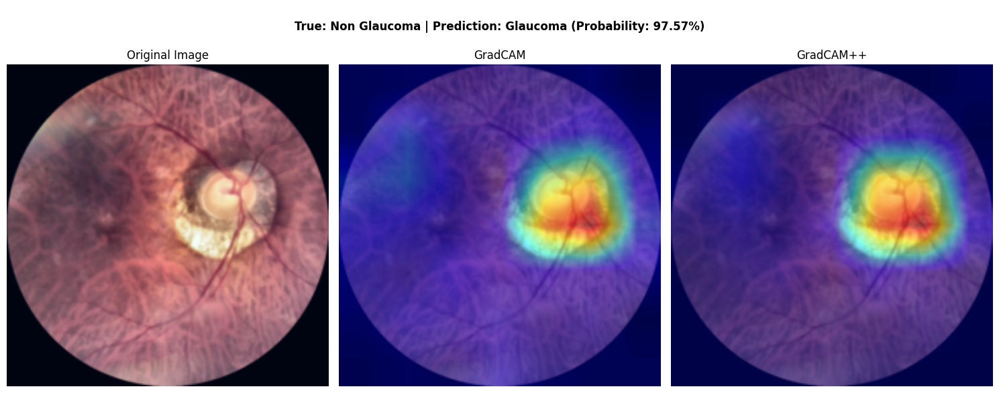


Analyzing image 21/25


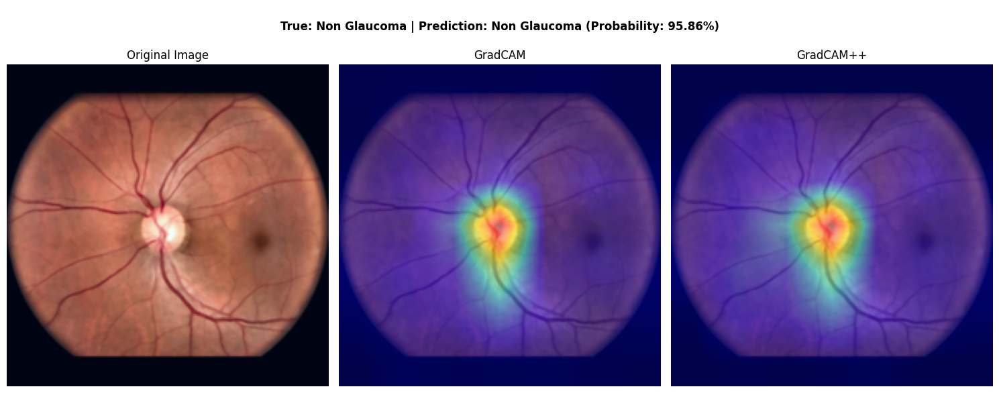


Analyzing image 22/25


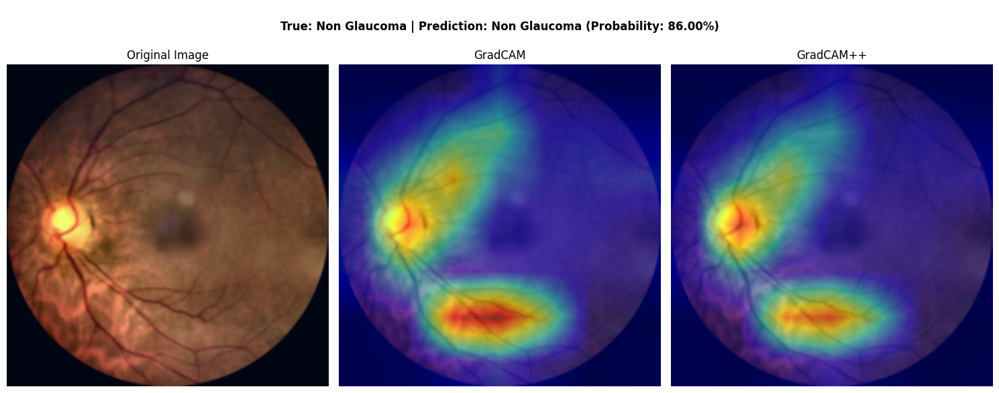


Analyzing image 23/25


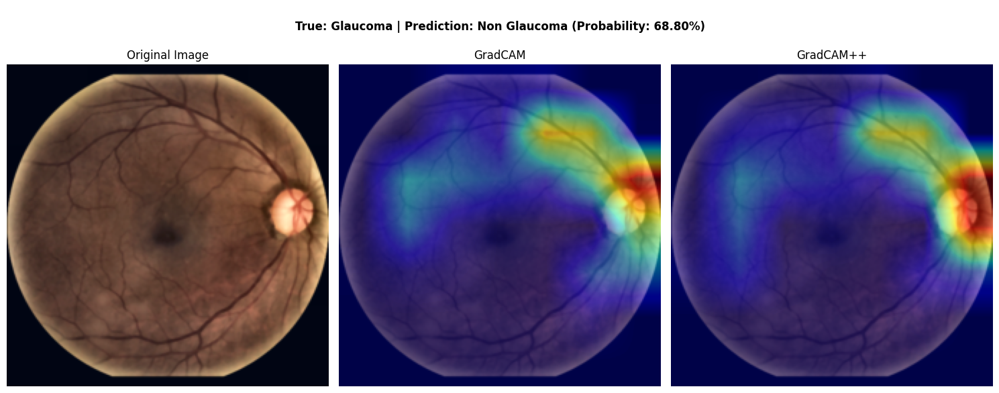


Analyzing image 24/25


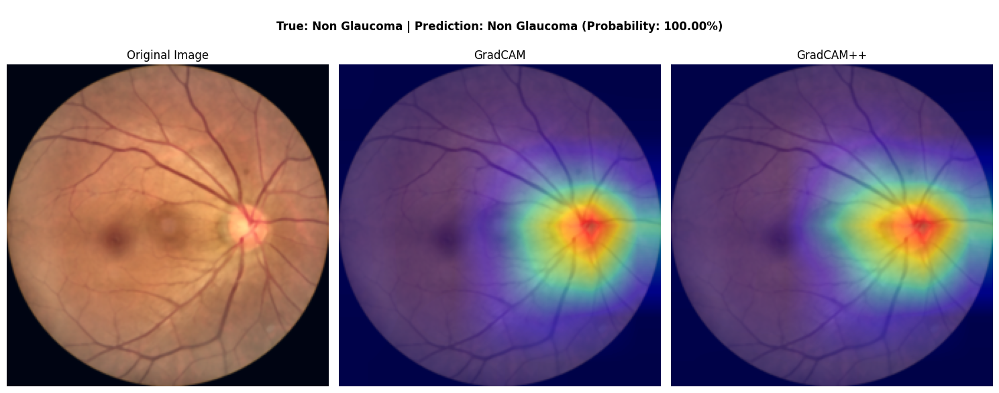


Analyzing image 25/25


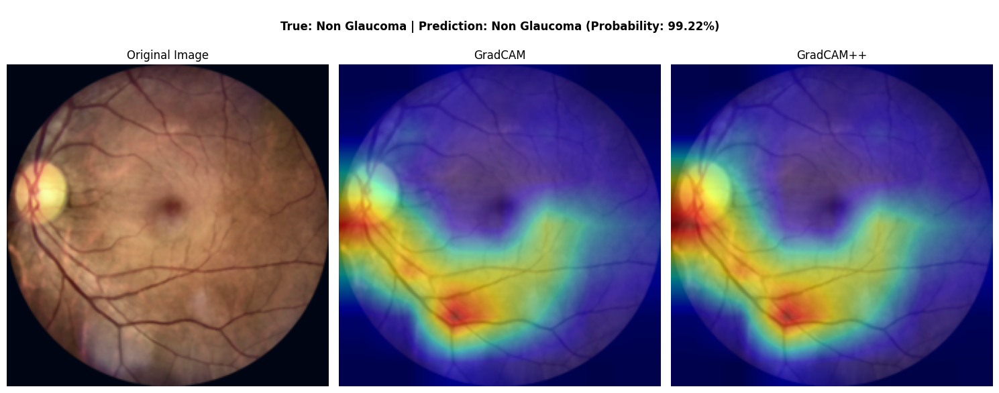

In [30]:
from matplotlib import gridspec

def visualize_gradcam(model, image_tensor, label_mapping, true_label=None):
    # Initialize GradCAM and GradCAM++
    gradcam = GradCAM(model)
    gradcam_pp = GradCAMPlusPlus(model)
    
    # Get model prediction and probability
    model.eval()
    with torch.no_grad():
        output = model(image_tensor)
        probs = F.softmax(output, dim=1)
        pred_idx = output.argmax(dim=1).item()
        probability = probs[0][pred_idx].item()
    
    # Generate heatmaps
    gradcam_map = gradcam(image_tensor)
    gradcam_pp_map = gradcam_pp(image_tensor)
    
    # Convert image tensor to numpy array
    image = image_tensor.squeeze().cpu().numpy().transpose(1, 2, 0)
    
    # Normalize image for display
    image = (image - image.min()) / (image.max() - image.min())
    
    # Create figure with extra vertical space for titles
    fig = plt.figure(figsize=(15, 6))
    
    # Create GridSpec to allow for title space
    gs = gridspec.GridSpec(2, 3, height_ratios=[1, 8])
    
    # Plot original image
    ax0 = plt.subplot(gs[1, 0])
    ax0.imshow(image)
    ax0.set_title('Original Image')
    ax0.axis('off')
    
    # Plot GradCAM
    ax1 = plt.subplot(gs[1, 1])
    ax1.imshow(image)
    ax1.imshow(cv2.resize(gradcam_map[0], (image.shape[1], image.shape[0])), 
               cmap='jet', alpha=0.5)
    ax1.set_title('GradCAM')
    ax1.axis('off')
    
    # Plot GradCAM++
    ax2 = plt.subplot(gs[1, 2])
    ax2.imshow(image)
    ax2.imshow(cv2.resize(gradcam_pp_map, (image.shape[1], image.shape[0])), 
               cmap='jet', alpha=0.5)
    ax2.set_title('GradCAM++')
    ax2.axis('off')
    
    # Add prediction info in the extra space
    pred_class = label_mapping[pred_idx]
    if true_label is not None:
        true_class = label_mapping[true_label]
        title_text = f'True: {true_class} | Prediction: {pred_class} (Probability: {probability:.2%})'
    else:
        title_text = f'Prediction: {pred_class} (Probability: {probability:.2%})'
    
    # Create a title axes that spans all columns
    title_ax = plt.subplot(gs[0, :])
    title_ax.axis('off')
    title_ax.text(0.5, 0.5, title_text, 
                 horizontalalignment='center',
                 verticalalignment='center',
                 fontsize=12,
                 fontweight='bold')
    
    plt.tight_layout()
    plt.show()

def show_gradcam_batch(model, dataloader, label_mapping, num_images=5):
    device = next(model.parameters()).device
    
    for i, (images, labels) in enumerate(dataloader):
        if i >= num_images:
            break
            
        image = images[0].unsqueeze(0).to(device)
        true_label = labels[0].item()
        
        print(f"\nAnalyzing image {i+1}/{num_images}")
        visualize_gradcam(model, image, label_mapping, true_label)


show_gradcam_batch(model, test_loader, label_mapping, num_images=25)